# XPCS&XSVS Pipeline for Single-(Gi)-SAXS Run
"This notebook corresponds to version {{ version }} of the pipeline tool: https://github.com/NSLS-II/pipelines"

This notebook begins with a raw time-series of images and ends with $g_2(t)$ for a range of $q$, fit to an exponential or stretched exponential, and a two-time correlation functoin.

## Overview

* Setup: load packages/setup path
* Load Metadata & Image Data
* Apply Mask
* Clean Data: shutter open/bad frames
* Get Q-Map
* Get 1D curve
* Define Q-ROI (qr, qz)
* Check beam damage
* One-time Correlation
* Fitting
* Two-time Correlation
The important scientific code is imported from the [chxanalys](https://github.com/yugangzhang/chxanalys/tree/master/chxanalys) and [scikit-beam](https://github.com/scikit-beam/scikit-beam) project. Refer to chxanalys and scikit-beam for additional documentation and citation information.

### DEV
* V8: Update visbility error bar calculation using pi = his/N +/- sqrt(his_i)/N
*     Update normlization in g2 calculation uing 2D-savitzky golay (SG ) smooth

## CHX Olog NoteBook
CHX Olog (https://logbook.nsls2.bnl.gov/11-ID/)

## Setup

Import packages for I/O, visualization, and analysis.

In [15]:
# %reset
uids = ['dfeb2151-2220-43e8-bba6-0577b21e8d9a','56897b08-283b-4e0a-aba5-0b6fd60251d7','8d8c8646-c582-4a86-a799-dde5e98a5603','725317e9-a9d5-4c9e-9a2f-167341cd3af6','3bdad54c-0daa-4035-981a-f5cc408a0076','339abcf7-e7ce-4766-89e7-c81dcb2416d4','6a6a27f4-158a-435c-b1eb-020bbff1ae38','f8ef1c87-9663-4540-b12c-e15581aa4df8','36530684-7b71-4d5c-b340-09001c6216d5','c052511e-b780-40fe-9c9a-9df04e1d395b','f9e6b84f-a636-43e8-a2ab-204dbe471864','2f578a6d-f489-4951-830d-2cad562bc96f','5f200a4b-a2c8-4c10-b991-59990e151fc7','3d5ea25e-f7ba-4847-b3cd-dc7f0fa5380d','3d5ea25e-f7ba-4847-b3cd-dc7f0fa5380d','3d5ea25e-f7ba-4847-b3cd-dc7f0fa5380d','ce0e9489-ebdd-41b0-ad00-897ebd55f5c3']

In [16]:
from pyCHX.chx_packages import *
%matplotlib notebook
plt.rcParams.update({'figure.max_open_warning': 0})
plt.rcParams.update({ 'image.origin': 'lower'   })
plt.rcParams.update({ 'image.interpolation': 'none'   })
import pickle as cpk
from pyCHX.chx_xpcs_xsvs_jupyter_V1 import *
import itertools
from pyCHX.SAXS import poly_sphere_form_factor_intensity

In [17]:
#%matplotlib notebook
%matplotlib inline

## Control Runs Here

In [18]:
#scat_geometry = 'saxs'  #suport 'saxs', 'gi_saxs', 'ang_saxs' (for anisotropics saxs or flow-xpcs)
#scat_geometry = 'ang_saxs' 
#scat_geometry = 'gi_waxs' 
scat_geometry = 'gi_saxs'


roi_auto =  False #True #False #True #if True, will automatically create a roi based on the roi_type ( iso/aniso etc), currently only works for SAXS
fit_peak = False #True

analysis_type_auto = False #True #if True, will take "analysis type" option from data acquisition func series
qphi_analysis =  False #True #False  #if True, will do q-phi (anisotropic analysis for transmission saxs)

isotropic_Q_mask = 'normal' #'wide' # 'normal' # 'wide'  ## select wich Q-mask to use for rings: 'normal' or 'wide'
phi_Q_mask = 'phi_4x_20deg'   ## select wich Q-mask to use for phi analysis
q_mask_name = ''

force_compress = False #True   #force to compress data 
bin_frame = False   #generally make bin_frame as False
para_compress = True    #parallel compress
run_fit_form = False    #run fit form factor 
run_waterfall =  False #True #False #True   #run waterfall analysis
run_profile_plot = True #False  #run prolfile plot for gi-saxs
run_t_ROI_Inten = True  #run  ROI intensity as a function of time
run_get_mass_center = False  # Analysis for mass center of reflective beam center
run_invariant_analysis = False
run_one_time =  True  #run  one-time
cal_g2_error =  False  #True  #calculate g2 signal to noise
#run_fit_g2 = True       #run  fit one-time, the default function is "stretched exponential"
fit_g2_func = 'stretched'
run_two_time =   False #True    #run  two-time
run_four_time = False #True #True #False   #run  four-time
run_xsvs= False # True #False         #run visibility analysis
att_pdf_report = True    #attach the pdf report to CHX olog
qth_interest = 7 #the intested single qth     

use_sqnorm = True    #if True, use sq to normalize intensity
use_SG = True #False #True # False        #if True, use the Sawitzky-Golay filter of the avg_img for normalization
use_SG_bin_frames =  False   #if True, use the Sawitzky-Golay filter of the (binned) frame for normalization 

use_imgsum_norm= True  #if True use imgsum to normalize intensity for one-time calculatoin
pdf_version='_%s'%get_today_date()     #for pdf report name
run_dose = False # True # False #True # True #False  #run dose_depend analysis


if scat_geometry == 'gi_saxs':run_xsvs= False;use_sqnorm=False
if scat_geometry == 'gi_waxs':use_sqnorm = False
if scat_geometry != 'saxs':qphi_analysis = False;scat_geometry_ = scat_geometry;roi_auto = False  
else:scat_geometry_ = ['','ang_'][qphi_analysis]+ scat_geometry   
if scat_geometry != 'gi_saxs':run_profile_plot = False

In [19]:
scat_geometry, scat_geometry_, qphi_analysis

('gi_saxs', 'gi_saxs', False)

In [20]:
taus=None;g2=None;tausb=None;g2b=None;g12b=None;taus4=None;g4=None;times_xsv=None;contrast_factorL=None; lag_steps = None 

## Make a directory for saving results

In [21]:
CYCLE= '2019_2'  #change clycle here
path = '/XF11ID/analysis/%s/masks/'%CYCLE

## Load Metadata & Image Data



### Change this line to give a uid

In [22]:
username      =  getpass.getuser()
uid = '887b6b5d'
uid = 'b5e319df' #] (scan num: 19486) (Measurement: test contrast and stabilityPM20190808_Ge_250C )


print(uid)
username = 'pmyint'

roi_auto = False # True #False #True #if True, will automatically create a roi based on the roi_type ( iso/aniso etc), currently only works for SAXS
run_two_time  =   True 
run_dose      =   False 



b5e319df


In [23]:
# Parameters
uid = uids[0]
username = "pmyint"
run_two_time = True
run_dose = False


In [24]:
#db[-1]

In [25]:
#get_last_uids( -2)

In [26]:
data_dir0  = create_user_folder(CYCLE, username)
print( data_dir0 )

Results from this analysis will be stashed in the directory /XF11ID/analysis/2019_2/pmyint/Results/
/XF11ID/analysis/2019_2/pmyint/Results/


In [27]:
uid = uid[:8]
print('The current uid for analysis is: %s...'%uid)

The current uid for analysis is: dfeb2151...


In [28]:
sud = get_sid_filenames(db[uid])
for pa in sud[2]:
    if 'master.h5' in pa:
        data_fullpath = pa
print ('scan_id, full-uid, data path are:  %s--%s--%s'%(sud[0], sud[1], data_fullpath ))

#start_time, stop_time = '2017-2-24  12:23:00', '2017-2-24  13:42:00' 
#sids, uids, fuids  = find_uids(start_time, stop_time)

scan_id, full-uid, data path are:  7205--dfeb2151-2220-43e8-bba6-0577b21e8d9a--/nsls2/xf11id1/data/2019/03/29/d6041ae0-8775-4361-a5a9_22790_master.h5


In [29]:
data_dir = os.path.join(data_dir0, '%s/'%(sud[1]))
os.makedirs(data_dir, exist_ok=True)
print('Results from this analysis will be stashed in the directory %s' % data_dir)
uidstr = 'uid=%s'%uid

Results from this analysis will be stashed in the directory /XF11ID/analysis/2019_2/pmyint/Results/dfeb2151-2220-43e8-bba6-0577b21e8d9a/


# Don't Change the lines below here

* get metadata

In [30]:
md = get_meta_data( uid )
md_blue = md.copy()
#md_blue

More than one device. This would have unintented consequences.Currently, only the device contains 'default_dec=eiger'.


In [31]:
#md_blue['detectors'][0]
#if md_blue['OAV_mode'] != 'none':
#    cx , cy = md_blue[md_blue['detectors'][0]+'_beam_center_x'], md_blue[md_blue['detectors'][0]+'_beam_center_x']
#else: 
#    cx , cy = md_blue['beam_center_x'], md_blue['beam_center_y']
#print(cx,cy)

In [32]:
detectors = sorted(get_detectors(db[uid]))
print('The detectors are:%s'%detectors)
if len(detectors) >1:
    md['detector'] = detectors[1]
    print( md['detector'])


The detectors are:['eiger4m_single_image']


In [33]:
if md['detector'] =='eiger4m_single_image' or md['detector'] == 'image':    
    reverse= True
    rot90= False
elif md['detector'] =='eiger500K_single_image':    
    reverse= True
    rot90=True
elif md['detector'] =='eiger1m_single_image':    
    reverse= True
    rot90=False
print('Image reverse: %s\nImage rotate 90: %s'%(reverse, rot90))    

Image reverse: True
Image rotate 90: False


In [34]:
try:
    cx , cy = md_blue['beam_center_x'], md_blue['beam_center_y']
    print(cx,cy)
except:
    print('Will find cx,cy later.')


Will find cx,cy later.


### Load ROI defined by "XPCS_Setup" Pipeline

#### Define data analysis type

In [35]:
if analysis_type_auto:#if True, will take "analysis type" option from data acquisition func series
    try:
        if scat_geometry != 'gi_saxs':
            qphi_analysis_ = md['analysis'] #if True, will do q-phi (anisotropic analysis for transmission saxs)
            print(md['analysis'])
            if qphi_analysis_ == 'iso':
                qphi_analysis = False
            elif qphi_analysis_ == '':
                qphi_analysis = False
            else:
                qphi_analysis = True
            #for other analysis type, in case of GiSAXS, low_angle/high_anlge for instance    
        else:
            gisaxs_inc_type = md['analysis'] 
        
    except:
        gisaxs_inc_type = None
        print('There is no analysis in metadata.')
        
print('Will %s qphis analysis.'%['NOT DO','DO'][qphi_analysis]) 

if scat_geometry != 'saxs':qphi_analysis = False;scat_geometry_ = scat_geometry  
else:scat_geometry_ = ['','ang_'][qphi_analysis]+ scat_geometry   
if scat_geometry != 'gi_saxs':run_profile_plot = False     
    
print(scat_geometry_)    

Will NOT DO qphis analysis.
gi_saxs


In [36]:
scat_geometry

'gi_saxs'

In [37]:
#%run /home/yuzhang/pyCHX_link/pyCHX/chx_generic_functions.py

* get data

In [38]:
imgs = load_data( uid, md['detector'], reverse= reverse, rot90=rot90  )
md.update( imgs.md );Nimg = len(imgs);
#md['beam_center_x'], md['beam_center_y']  = cx, cy
#if 'number of images'  not in list(md.keys()):
md['number of images']  = Nimg
pixel_mask =  1- np.int_( np.array( imgs.md['pixel_mask'], dtype= bool)  )
print( 'The data are: %s' %imgs )

#md['acquire period' ] = md['cam_acquire_period']
#md['exposure time'] =  md['cam_acquire_time']
mdn = md.copy()


The data are: Pipeline processed through proc_func. Original repr:
    EigerImages processed through proc_func. Original repr:
        <Frames>
        Length: 3800 frames
        Frame Shape: 2167 x 2070
        Pixel Datatype: uint32


#### Load Chip mask depeding on detector

In [39]:
if md['detector'] =='eiger1m_single_image':
    Chip_Mask=np.load( '/XF11ID/analysis/2017_1/masks/Eiger1M_Chip_Mask.npy')
elif md['detector'] =='eiger4m_single_image' or md['detector'] == 'image':    
    Chip_Mask= np.array(np.load( '/XF11ID/analysis/2017_1/masks/Eiger4M_chip_mask.npy'), dtype=bool)
    BadPix =     np.load('/XF11ID/analysis/2018_1/BadPix_4M.npy'  )  
    Chip_Mask.ravel()[BadPix] = 0
elif md['detector'] =='eiger500K_single_image':
    #print('here')
    Chip_Mask=  np.load( '/XF11ID/analysis/2017_1/masks/Eiger500K_Chip_Mask.npy')  #to be defined the chip mask
    Chip_Mask = np.rot90(Chip_Mask)
    pixel_mask = np.rot90(  1- np.int_( np.array( imgs.md['pixel_mask'], dtype= bool))   )
    
else:
    Chip_Mask = 1
print(Chip_Mask.shape, pixel_mask.shape)

(2167, 2070) (2167, 2070)


In [40]:
use_local_disk = True
import shutil,glob

In [41]:
save_oavs = False
if len(detectors)==2:
    if '_image' in md['detector']:
        pref = md['detector'][:-5]
    else:
        pref=md['detector']
    for k in [ 'beam_center_x', 'beam_center_y','cam_acquire_time','cam_acquire_period','cam_num_images',
             'wavelength', 'det_distance', 'photon_energy']:
        md[k] =  md[ pref + '%s'%k]    
    
    if 'OAV_image' in detectors:
        try:
            save_oavs_tifs(  uid, data_dir )
            save_oavs = True
        except:
            pass
        

In [42]:
print_dict( md,  ['suid', 'number of images', 'uid', 'scan_id', 'start_time', 'stop_time', 'sample', 'Measurement',
                  'acquire period', 'exposure time',  
         'eiger4m_single_det_distance', 'beam_center_x', 'beam_center_y', ] )

suid--> dfeb2151
number of images--> 3800
uid--> dfeb2151-2220-43e8-bba6-0577b21e8d9a
scan_id--> 7205
start_time--> 2019-03-29 20:29:04
stop_time--> 2019-03-29 20:44:56
sample--> sam1_SiO2
Measurement--> 65Ar+bombardment, base pressure 5.2 10-6, fan on,  water on,  CHX mech pump on
acquire period--> 0.25
exposure time--> 0.25
eiger4m_single_det_distance--> 10.303531690000002
beam_center_x--> 1109.0
beam_center_y--> 1936.0


In [43]:
print_dict(md)

suid--> dfeb2151
filename--> /nsls2/xf11id1/data/2019/03/29/d6041ae0-8775-4361-a5a9_22790_master.h5
detector--> eiger4m_single_image
eiger4m_single_cam_acquire_period--> 0.25
eiger4m_single_cam_acquire_time--> 0.24999402463436127
eiger4m_single_cam_num_images--> 3800
eiger4m_single_beam_center_x--> 1109.0
eiger4m_single_beam_center_y--> 1936.0
eiger4m_single_wavelength--> 1.2848103046417236
eiger4m_single_det_distance--> 10.303531690000002
eiger4m_single_threshold_energy--> 4825.0
eiger4m_single_photon_energy--> 9650.0
eiger4m_single_stats1_configuration_names--> ['eiger4m_single_stats1_configuration_names', 'eiger4m_single_stats1_port_name', 'eiger4m_single_stats1_asyn_pipeline_config', 'eiger4m_single_stats1_blocking_callbacks', 'eiger4m_single_stats1_enable', 'eiger4m_single_stats1_nd_array_port', 'eiger4m_single_stats1_plugin_type', 'eiger4m_single_stats1_bgd_width', 'eiger4m_single_stats1_centroid_threshold', 'eiger4m_single_stats1_compute_centroid', 'eiger4m_single_stats1_compute

## Overwrite Some Metadata if Wrong Input

### Define incident beam center (also define reflection beam center for gisaxs)

In [44]:
if scat_geometry =='gi_saxs':
    
    inc_x0 = md['beam_center_x'] 
    inc_y0 =  imgs[0].shape[0] - md['beam_center_y']    
    
    refl_x0 =    md['beam_center_x'] 
    #inc_ang = 0.39
    #refl_y0 =     1780 #1000     #imgs[0].shape[0] -  1758      
    #refl_x0 =     md['beam_center_x']  
    inc_ang  =   abs(  float(db[uid]['start']['inc_angle'] ))
    #print(inc_ang)
    refl_x0, refl_y0 = inc_x0,  np.tan(2* np.radians(inc_ang))*md['eiger4m_single_det_distance']/0.075*1e3  + inc_y0
    
    #%run -i ~/analysis/Analysis_Pipelines/Develop/pyCHX/pyCHX/XPCS_GiSAXS.py
    #refl_x0, refl_y0 = get_refl_xy(  inc_ang= inc_ang, inc_phi=0, inc_x0= inc_x0, inc_y0= inc_y0, pixelsize=[0.075,0.075], Lsd= md['det_distance']*1000   )
  
   
    print( "inc_x0, inc_y0, ref_x0,ref_y0 are: %s %s %s %s."%(inc_x0, inc_y0, refl_x0, refl_y0) )
else:
    if md['detector'] =='eiger4m_single_image' or md['detector'] == 'image' or md['detector']=='eiger1m_single_image':    
        inc_x0 =  imgs[0].shape[0] - md['beam_center_y']   
        inc_y0=   md['beam_center_x']
    elif md['detector'] =='eiger500K_single_image':    
        inc_y0 =  imgs[0].shape[1] - md['beam_center_y']   
        inc_x0 =   imgs[0].shape[0] - md['beam_center_x']
    
    print(inc_x0, inc_y0)

    ###for this particular uid, manually give x0/y0
    #inc_x0 = 1041
    #inc_y0 = 1085

KeyError: 'inc_angle'

In [ ]:
dpix, lambda_, Ldet,  exposuretime, timeperframe, center = check_lost_metadata(
    md, Nimg, inc_x0 = inc_x0, inc_y0=   inc_y0, pixelsize = 7.5*10*(-5) )
if scat_geometry =='gi_saxs':center=center[::-1]
if uid == '4740b6b5-20cb-4ad1-9f7a-b7a2b3a77659':
    Ldet =  16.035*1000
    
#Ldet = 10.36*1e3
    
setup_pargs=dict(uid=uidstr, dpix= dpix, Ldet=Ldet, lambda_= lambda_, exposuretime=exposuretime,
        timeperframe=timeperframe, center=center, path= data_dir)
print_dict( setup_pargs )


In [ ]:
setup_pargs

## Apply Mask
* load and plot mask if exist 
* otherwise create a mask using Mask pipeline
* Reverse the mask in y-direction due to the coordination difference between python and Eiger software
* Reverse images in y-direction
* Apply the mask

# Change the lines below to give mask filename

In [ ]:
date = 'Aug15'


if scat_geometry == 'gi_saxs':
    mask_path = '/XF11ID/analysis/2019_2/masks/'    
    mask_name =  '%s_2019_4M_GiSAXS.npy'%date
    
elif scat_geometry == 'saxs':
    mask_path = '/XF11ID/analysis/2019_3/masks/'
    if md['detector'] =='eiger4m_single_image' or md['detector'] == 'image':    
        mask_name = '%s_2019_4M_SAXS.npy'%date   
        
    elif md['detector'] =='eiger500K_single_image':    
        mask_name = '%s_2019_500K_SAXS.npy'%date    
        
elif scat_geometry == 'gi_waxs':    
    mask_path = '/XF11ID/analysis/2019_3/masks/'    
    mask_name =  '%s_2019_1M_WAXS.npy'  
    

In [ ]:
mask = load_mask(mask_path, mask_name, plot_ =  False, image_name = uidstr + '_mask', reverse= reverse, rot90=rot90  ) 
mask =  mask * pixel_mask * Chip_Mask
show_img(mask,image_name = uidstr + '_mask', save=True, path=data_dir, aspect=1, center=center[::-1])
mask_load=mask.copy()
imgsa = apply_mask( imgs, mask )

# Check several frames average  intensity

#### Load ROI mask depending on data analysis type

In [ ]:
#%run ~/pyCHX_link/pyCHX/chx_generic_functions.py

In [ ]:
print(roi_auto, qphi_analysis, isotropic_Q_mask)

In [ ]:
##For SAXS 
roi_path = '/XF11ID/analysis/2019_3/masks/'
roi_date = 'Aug10'
#roi_date = 'May30B'


if scat_geometry =='saxs':
    ## For auto load roi mask
    if roi_auto: 
        general_path = '/nsls2/xf11id1/analysis/2017_1/masks/'
        roi_mask_norm = general_path + 'general_roi_mask_norm.npy' 
        roi_mask_wide = general_path + 'general_roi_mask_wide.npy' 
        roi_mask_phi_4x_20deg = general_path + 'general_roi_mask_phi_4x_20deg.npy' 
        roi_mask_12x_30deg = general_path + 'general_roi_mask_12x_30deg.npy' 
        roi_mask_12x_15deg_flow = general_path + 'general_roi_mask_12x_15deg_flow.npy'
        if qphi_analysis ==  False:
            if isotropic_Q_mask == 'normal':
                fp = roi_mask_norm
            elif isotropic_Q_mask == 'wide':
                fp = roi_mask_wide
        elif qphi_analysis:
            if phi_Q_mask == 'phi_4x_20deg':
                fp = roi_mask_phi_4x_20deg
            elif phi_Q_mask == 'phi_12x_30deg': 
                fp = roi_mask_phi_12x_30deg
            elif phi_Q_mask == 'phi_12x_15deg_flow': 
                fp = roi_mask_phi_12x_15deg_flow 
        roi_mask0 = np.load(fp)    
        old_cen=[4000,4000]        
        roi_mask, qval_dict, qwid_dict = get_roi_mask_qval_qwid_by_shift( 
                        new_cen=center, new_mask= mask, old_cen=old_cen,
                                    old_roi_mask=roi_mask0, limit_qnum= None,
                                    setup_pargs= setup_pargs,  geometry = scat_geometry_,
                                    ) 
 
    else: 
        if qphi_analysis ==  False:
            if isotropic_Q_mask == 'normal':
                #print('Here')
                q_mask_name='rings'
                if md['detector'] =='eiger4m_single_image' or md['detector'] == 'image': #for 4M 
                    fp = roi_path + 'roi_mask_%s_4M_norm.pkl'%roi_date                 

                elif md['detector'] =='eiger500K_single_image': #for 500K   
                    fp = roi_path + 'roi_mask_%s_500K_norm.pkl'%roi_date   


            elif isotropic_Q_mask == 'wide':
                q_mask_name='wide_rings'
                if md['detector'] =='eiger4m_single_image' or md['detector'] == 'image': #for 4M   
                    fp = roi_path + 'roi_mask_%s_4M_wide.pkl'%roi_date   
                elif md['detector'] =='eiger500K_single_image': #for 500K   
                    fp = roi_path + 'roi_mask_%s_500K_wide.pkl'%roi_date   


        elif qphi_analysis:
            if phi_Q_mask =='phi_4x_20deg':
                q_mask_name='phi_4x_20deg'
                if md['detector'] =='eiger4m_single_image' or md['detector'] == 'image': #for 4M 
                    fp = roi_path + 'roi_mask_%s_4M_phi_4x_20deg.pkl'%roi_date   
                elif md['detector'] =='eiger500K_single_image': #for 500K 
                    fp = roi_path + 'roi_mask_%s_500K_phi_4x_20deg.pkl'%roi_date   


        #fp = 'XXXXXXX.pkl'            
        roi_mask,qval_dict = cpk.load( open(fp, 'rb' )  )  #for load the saved roi data
        print(fp)

## Gi_SAXS 
elif scat_geometry =='gi_saxs': 
    
    # static mask    
    #ss =  '887b6b5d'
    ss =   '28d8f37c'
    
    
    fp = '/XF11ID/analysis/2019_2/masks/uid=%s_roi_masks.pkl'%ss
    roi_masks,qval_dicts = cpk.load( open(fp, 'rb' )  )  #for load the saved roi data    
    print('The static mask is: %s.'%fp)    

    fp = '/XF11ID/analysis/2019_2/masks/uid=%s_roi_mask.pkl'%(ss)
    roi_mask,qval_dict = cpk.load( open(fp, 'rb' )  )  #for load the saved roi data
    print('The dynamic mask is: %s.'%fp)
    # q-map
    fp = '/XF11ID/analysis/2019_2/masks/uid=%s_qmap.pkl'%(ss)
    #print(fp)
    qr_map, qz_map, ticks, Qrs, Qzs,  Qr, Qz, inc_x0,refl_x0, refl_y0 = cpk.load( open(fp, 'rb' )  )
    print('The qmap is: %s.'%fp)
    
## WAXS 
elif scat_geometry =='gi_waxs': 
    #fp = '/XF11ID/analysis/2019_1/masks/uid=ca2ccb14_roi_mask_5PTO_130C_PTO.pkl'     
    fp =  '/XF11ID/analysis/2019_2/masks/uid=278c0df1_roi_mask.pkl'
    
    roi_mask,qval_dict = cpk.load( open(fp, 'rb' )  )  #for load the saved roi data

print(roi_mask.shape)

In [ ]:
#qval_dict

In [ ]:
#roi_mask = shift_mask(roi_mask, 10,30)  #if shift mask to get new mask
show_img(roi_mask, aspect=1.0, image_name = fp)#, center=center[::-1])


In [ ]:
img_choice_N = 1
img_samp_index = random.sample( range(len(imgs)), img_choice_N) 
avg_img =  get_avg_img( imgsa, img_samp_index, plot_ = False, uid =uidstr)
if avg_img.max() == 0:
    print('There are no photons recorded for this uid: %s'%uid)
    print('The data analysis should be terminated! Please try another uid.')


In [ ]:
#show_img( imgsa[1000],  vmin=.1, vmax= 1e1, logs=True, aspect=1,
#         image_name= uidstr + '_img_avg',  save=True, path=data_dir,  cmap = cmap_albula )
print(center[::-1])

In [ ]:
show_img( imgsa[ 5],  vmin = 1, vmax = 10, logs=False, aspect=1, #save_format='tif',
         image_name= uidstr + '_img_avg',  save=True, path=data_dir, cmap=cmap_albula,center=center[::-1])
# select subregion, hard coded center beam location
#show_img( imgsa[180+40*3/0.05][110:110+840*2, 370:370+840*2],  vmin = 0.01, vmax = 20, logs=False, aspect=1, #save_format='tif',
#         image_name= uidstr + '_img_avg',  save=True, path=data_dir, cmap=cmap_albula,center=[845,839])

## Compress Data
* Generate a compressed data with filename
* Replace old mask with a new mask with removed hot pixels
* Do average image
* Do each image sum
* Find badframe_list for where image sum above bad_pixel_threshold
* Check shutter open frame to get good time series


In [ ]:
compress=True
photon_occ = len( np.where(avg_img)[0] ) / ( imgsa[0].size)
#compress =  photon_occ < .4  #if the photon ocupation < 0.5, do compress
print ("The non-zeros photon occupation is %s."%( photon_occ))
print("Will " + 'Always ' + ['NOT', 'DO'][compress]  + " apply compress process.")

In [ ]:
if  md['detector'] =='eiger4m_single_image' or md['detector'] == 'image':    
    good_start =    5  #make the good_start at least 0
elif md['detector'] =='eiger500K_single_image': 
    good_start = 5#100  #5  #make the good_start at least 0
    
elif  md['detector'] =='eiger1m_single_image' or md['detector'] == 'image':    
    good_start =    5    

In [ ]:
bin_frame =  False # True  #generally make bin_frame as False
if bin_frame:
    bin_frame_number=4
    acquisition_period = md['acquire period']
    timeperframe = acquisition_period * bin_frame_number
else:
    bin_frame_number =1

In [ ]:
force_compress = False
#force_compress = True

In [ ]:
import time
t0= time.time()

if not use_local_disk:
    cmp_path = '/nsls2/xf11id1/analysis/Compressed_Data'
else:
    cmp_path = '/tmp_data/compressed'
    
    
cmp_path = '/nsls2/xf11id1/analysis/Compressed_Data'    
if bin_frame_number==1:   
    cmp_file = '/uid_%s.cmp'%md['uid']
else:
    cmp_file = '/uid_%s_bined--%s.cmp'%(md['uid'],bin_frame_number)
    
filename = cmp_path + cmp_file  
mask2, avg_img, imgsum, bad_frame_list = compress_eigerdata(imgs, mask, md, filename, 
         force_compress= force_compress,  para_compress= para_compress,  bad_pixel_threshold = 1e14,
                                    reverse=reverse, rot90=rot90,
                        bins=bin_frame_number, num_sub= 100, num_max_para_process= 500, with_pickle=True,
                        direct_load_data =use_local_disk, data_path = data_fullpath, )                                  
                                                         
min_inten = 10    
good_start = max(good_start, np.where( np.array(imgsum) > min_inten )[0][0] )    
print ('The good_start frame number is: %s '%good_start)

FD = Multifile(filename, good_start, len(imgs)//bin_frame_number )
#FD = MultifileBNLCustom(filename, good_start, len(imgs)//bin_frame_number )

###For test purpose to use the first 1000 frames
####################################################################
#FD = MultifileBNLCustom(filename, good_start, 500 )
#FD = Multifile(filename, good_start, 500)
############################################################


uid_ = uidstr + '_fra_%s_%s'%(FD.beg, FD.end)
print( uid_ )
plot1D( y = imgsum[ np.array( [i for i in np.arange(good_start, len(imgsum)) if i not in bad_frame_list])],
       title =uidstr + '_imgsum', xlabel='Frame', ylabel='Total_Intensity', legend='imgsum'   )
Nimg = Nimg/bin_frame_number
run_time(t0)

mask2 =  mask * pixel_mask * Chip_Mask
mask_copy = mask.copy()
mask_copy2 = mask.copy()

avg_img *= mask

In [ ]:
#%run ~/pyCHX_link/pyCHX/chx_generic_functions.py

In [ ]:
try:
    if md['experiment']=='printing':
        #p = md['printing'] #if have this printing key, will do error function fitting to find t_print0
        find_tp0 = True
        t_print0 = ps(  y = imgsum[:400] ) * timeperframe
        print( 'The start time of print: %s.' %(t_print0  ) )
    else:
        find_tp0 = False
        print('md[experiment] is not "printing" -> not going to look for t_0')
        t_print0 = None
except:
    find_tp0 = False
    print('md[experiment] is not "printing" -> not going to look for t_0')
    t_print0 = None


In [ ]:
show_img( avg_img*mask,  vmin=1e-5, vmax= 1e3, logs=True, aspect=1, #save_format='tif',
         image_name= uidstr + '_img_avg',  save=True, 
         path=data_dir, center=center[::-1], cmap = cmap_albula )  #plt.cm.jet )#

## Get bad frame list by a polynominal fit

In [ ]:
good_end= None # 2000  
if good_end is not None:
    FD = Multifile(filename, good_start, min( len(imgs)//bin_frame_number, good_end) )
    uid_ = uidstr + '_fra_%s_%s'%(FD.beg, FD.end)
    print( uid_ )
    

In [ ]:
re_define_good_start =False
if re_define_good_start:
    good_start = 180
    #good_end = 19700
    good_end = len(imgs)
    FD = Multifile(filename, good_start, good_end) 
    uid_ = uidstr + '_fra_%s_%s'%(FD.beg, FD.end)
    print( FD.beg, FD.end)

In [ ]:
bad_frame_list =  get_bad_frame_list( imgsum, fit='both',  plot=True,polyfit_order = 30,                                      
                        scale= 3.5,  good_start = good_start, good_end=good_end, uid= uidstr, path=data_dir)

print( 'The bad frame list length is: %s'%len(bad_frame_list) )

### Creat new mask by masking the bad pixels and get new avg_img

In [ ]:
imgsum_y = imgsum[ np.array( [i for i in np.arange( len(imgsum)) if i not in bad_frame_list])]
imgsum_x = np.arange( len( imgsum_y))
save_lists(  [imgsum_x, imgsum_y], label=['Frame', 'Total_Intensity'],
           filename=uidstr + '_img_sum_t', path= data_dir  )


### Plot time~ total intensity of each frame

In [ ]:
plot1D( y = imgsum_y, title = uidstr + '_img_sum_t', xlabel='Frame', c='b',
       ylabel='Total_Intensity', legend='imgsum', save=True, path=data_dir)

## Get Dynamic Mask (currently designed for 500K)

In [ ]:
if  md['detector'] =='eiger4m_single_image' or md['detector'] == 'image':    
    pass
elif md['detector'] =='eiger500K_single_image':  
    #if md['cam_acquire_period'] <= 0.00015:  #will check this logic
    if imgs[0].dtype == 'uint16':
        print('Create dynamic mask for 500K due to 9K data acquistion!!!')
        bdp = find_bad_pixels_FD( bad_frame_list, FD, img_shape = avg_img.shape, threshold=20 )    
        mask = mask_copy2.copy()
        mask *=bdp 
        mask_copy = mask.copy()
        show_img(  mask, image_name='New Mask_uid=%s'%uid )

# Static Analysis

## SAXS Scattering Geometry

In [ ]:
setup_pargs 

In [ ]:
if scat_geometry =='saxs':
    ## Get circular average| * Do plot and save q~iq
    mask = mask_copy.copy()
    hmask = create_hot_pixel_mask( avg_img, threshold = 1e8, center=center, center_radius= 10)
    
    qp_saxs, iq_saxs, q_saxs = get_circular_average( avg_img * Chip_Mask , mask * hmask, save=True,
                                                    pargs=setup_pargs  )
    plot_circular_average( qp_saxs, iq_saxs, q_saxs,  pargs=setup_pargs,  show_pixel=True,
                      xlim=[qp_saxs.min(), qp_saxs.max()*1.0], ylim = [iq_saxs.min(), iq_saxs.max()*2] )
    mask =np.array( mask * hmask, dtype=bool) 

## SAXS to fit the form factor


In [ ]:
if scat_geometry =='saxs':    
    if run_fit_form:  
        qp, pq =  q_saxs, iq_saxs
        fitp, fitpe,   q_, fitq, result    = get_form_factor_fit_lmfit( qp, pq, 
            guess_values={'radius': 1180, 'sigma':0.05,'delta_rho':1e-9, 'background':5e-5,  
                          'qpower_scale':5e-10, 'qpower': -4.0 }, 
            guess_limit = { 'radius': [1000, 1500],   'sigma':[1e-3, .5], 'delta_rho': [1e-16, 1e-4], 
                           'background':  [1e-6, 1e-3], 'qpower_scale': [1e-16, 1], 'qpower': [ -5,-3]},                                                
            fit_range=[0.005, 0.03], 
            fit_variables={'radius': True,  'sigma':True,  'delta_rho':True,  'background': True,
                            'qpower_scale':True,  'qpower':False},
            fit_func='G',    qpower_bg= True  )
        
        r,sig=fitp[ 'radius'], fitp['sigma']
        radius, sigma, delta_rho, background, qpower_scale, qpower =  (fitp[ 'radius'], fitp['sigma'],
                                                 fitp['delta_rho'],fitp['background'],
                                                 fitp[ 'qpower_scale'], fitp['qpower']    ) 
        bk= qpower_scale*qp**( qpower ) + background
        ff= poly_sphere_form_factor_intensity( qp, radius=radius, sigma=sigma, delta_rho=delta_rho, 
                                              background=0,  num_points= 20,
                                              spread=5,fit_func= 'G'  ) + bk
        #report_fit( result)

In [ ]:
if scat_geometry =='saxs':    
    if run_fit_form:  
        fig = plt.figure( )#figsize=[8,6]) 
        ax = fig.add_subplot( 1,1,1 )   
        plot1D(x=qp,y=pq,ax=ax,m='o', ls='',c='k', legend='data', logy=True) 
        #plot1D(x=q_,y=fitq,ax=ax,m='', ls='-',c='r', legend='fitG_bg', logy=True)#, logx=True ) 
        plot1D(x=qp,y=ff,ax=ax,m='', ls='-',c='b', legend='fitG_bgA', logy=True)#, logx=True ) 
        #plot1D(x=q, y = bk, ls='--',c='g',ax=ax, lw=1, markersize=2,)
        #qpower_scale, qpower
        plot1D(x=qp, y= qp**( qpower ) * np.exp( qpower_scale ) /1e8, ax=ax, m='', ls='-', c='k', legend= r'$q^{%.1f}$'% qpower) 

        txts = r'radius' + r' = %.2f +/- %.2f '%( radius/10, fitpe['radius'] ) +   r'$ nm$' 
        ax.text(x =0.02, y=.2, s=txts, fontsize=14, transform=ax.transAxes)
        txts = r'sigma' + r' = %.4f +/- %.4f'%( sigma, fitpe['sigma'])  
        #txts = r'$\beta$' + r'$ = %.3f$'%(beta[i]) +  r'$ s^{-1}$'
        ax.text(x =0.02, y=.1, s=txts, fontsize=14, transform=ax.transAxes)  

        ax.set_xscale('log')    
        #ax.set_ylim( [1.00, 1.15 ] )
        ax.set_xlabel(r'$q$ ('r'$\AA^{-1}$)', fontsize=18)        
        ax.set_ylabel(r'$I(q)$', fontsize=18)   
        #ax.set_title(  'uid=%s'%uid, fontsize=18)  
        plt.tight_layout()
        

In [ ]:
if scat_geometry =='saxs':  
    qr = np.array( [qval_dict[k][0] for k in sorted( qval_dict.keys())] )
    if qphi_analysis ==  False:
        try:
            qr_cal, qr_wid = get_QrQw_From_RoiMask( roi_mask, setup_pargs  ) 
            print(len(qr))         
            if (qr_cal - qr).sum() >=1e-3:
                print( 'The loaded ROI mask might not be applicable to this UID: %s.'%uid)
                print('Please check the loaded roi mask file.')
        except:
            print('Something is wrong with the roi-mask. Please check the loaded roi mask file.')            
            
    
    show_ROI_on_image( avg_img*roi_mask, roi_mask, center, label_on = False, rwidth = 840, alpha=.9,  
                 save=True, path=data_dir, uid=uidstr, vmin= 1e-3,
                 vmax= 1e-1, #np.max(avg_img),
                 aspect=1,
                 show_roi_edge=True,     
                 show_ang_cor = True) 
    plot_qIq_with_ROI( q_saxs, iq_saxs, np.unique(qr), logs=True, uid=uidstr, 
                      xlim=[q_saxs.min(), q_saxs.max()*1.02],#[0.0001,0.08],
                  ylim = [iq_saxs.min(), iq_saxs.max()*1.02],  save=True, path=data_dir)
    
    roi_mask = roi_mask * mask

In [ ]:
#fit one peak

In [ ]:
if scat_geometry =='saxs':
    if fit_peak:   
        q1 =  0.162
        x = q_saxs
        y= iq_saxs
        aind = [ find_index(  q_saxs, q1 ) ]
        w = 50
        xrange = [  aind[0] -w, aind[0] + w]        
        cen, cen_std, wid, wid_std, xf, out =  fit_one_peak_curve( x, y, xrange ) 
        fp = data_dir + uidstr + '_qIq_fit.png'         
        ax = plot_xy_with_fit(  x, y, xf, out, cen, cen_std,wid, wid_std,
                              xlim=[0.01,0.3],xlabel= 'q ('r'$\AA^{-1}$)',
                    ylabel='I(q)', filename=fp)
        

        
    

In [ ]:
if run_invariant_analysis:
    if scat_geometry =='saxs':
        invariant = get_iq_invariant( qt, iqst )
        time_stamp = time_edge[:,0] * timeperframe

    if scat_geometry =='saxs':
        plot_q2_iq( qt, iqst, time_stamp,pargs=setup_pargs,ylim=[ -0.001, 0.01] , 
                   xlim=[0.007,0.2],legend_size= 6  )

    if scat_geometry =='saxs':
        plot_time_iq_invariant( time_stamp, invariant, pargs=setup_pargs,  )

    if False:
        iq_int = np.zeros( len(iqst) )
        fig, ax = plt.subplots()
        q = qt
        for i in range(iqst.shape[0]):
            yi = iqst[i] * q**2
            iq_int[i] = yi.sum()
            time_labeli = 'time_%s s'%( round(  time_edge[i][0] * timeperframe, 3) )
            plot1D( x = q, y = yi, legend= time_labeli, xlabel='Q (A-1)', ylabel='I(q)*Q^2', title='I(q)*Q^2 ~ time',
                   m=markers[i], c = colors[i], ax=ax, ylim=[ -0.001, 0.01] , xlim=[0.007,0.2],
                  legend_size=4)

        #print( iq_int )

In [ ]:
if scat_geometry =='gi_saxs':    
    plot_qzr_map(  qr_map, qz_map, inc_x0, ticks = ticks, data= avg_img, uid= uidstr, path = data_dir   )

In [ ]:
if scat_geometry =='gi_saxs':    
    #roi_masks, qval_dicts = get_gisaxs_roi( Qrs, Qzs, qr_map, qz_map, mask= mask )
    show_qzr_roi(FD.rdframe(7), roi_masks, inc_x0, ticks[:4], alpha=0.5, save=True, path=data_dir, uid=uidstr )

In [ ]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
def show_label_array_on_image(ax, image, label_array, cmap=None,norm=None, log_img=True,alpha=0.3, vmin=0.1, vmax=5,
                              imshow_cmap='gray', **kwargs):  #norm=LogNorm(), 
    """
    This will plot the required ROI's(labeled array) on the image
    
    Additional kwargs are passed through to `ax.imshow`.
    If `vmin` is in kwargs, it is clipped to minimum of 0.5.
    Parameters
    ----------
    ax : Axes
        The `Axes` object to add the artist too
    image : array
        The image array
    label_array : array
        Expected to be an unsigned integer array.  0 is background,
        positive integers label region of interest
    cmap : str or colormap, optional
        Color map to use for plotting the label_array, defaults to 'None'
    imshow_cmap : str or colormap, optional
        Color map to use for plotting the image, defaults to 'gray'
    norm : str, optional
        Normalize scale data, defaults to 'Lognorm()'
    Returns
    -------
    im : AxesImage
        The artist added to the axes
    im_label : AxesImage
        The artist added to the axes
    """
    ax.set_aspect('equal')
    
    #print (vmin, vmax )
    if log_img:
        im = ax.imshow(image, cmap=imshow_cmap, interpolation='none',norm=LogNorm(vmin,  vmax),**kwargs)  #norm=norm,
    else:
        im = ax.imshow(image, cmap=imshow_cmap, interpolation='none',vmin=vmin, vmax=vmax,**kwargs)  #norm=norm,
        
    im_label = 0#mpl_plot.show_label_array(ax, label_array, cmap=cmap, vmin=vmin, vmax=vmax, alpha=alpha,
#                                 **kwargs)  # norm=norm,
    
    
    return im, im_label    
def show_qzr_roi( data, rois, inc_x0, ticks, alpha=0.3, vmin=0.01, vmax=30. ,
                 uid='uid', path = '', save=False, return_fig=False, *argv,**kwargs):  
        
    ''' 
    Dec 16, 2015, Y.G.@CHX
    plot a qzr map of a gisaxs image with rois( a label array) 
    
    Parameters:
        data: 2-D array, a gisaxs image 
        rois:  2-D array, a label array         
        inc_x0:  the incident beam center x 
        ticks:  zticks, zticks_label, rticks, rticks_label = ticks
            zticks: list, z-tick positions in unit of pixel
            zticks_label: list, z-tick positions in unit of real space
            rticks: list, r-tick positions in unit of pixel
            rticks_label: list, r-tick positions in unit of real space
         
    Options:
        alpha:  transparency of the label array on top of data
        
    Return:
         a plot of a qzr map of a gisaxs image with rois( a label array)
   
    
    Examples:        
        show_qzr_roi( avg_imgr, box_maskr, inc_x0, ticks)
         
    '''
    zticks, zticks_label, rticks, rticks_label = ticks
    avg_imgr, box_maskr = data, rois
    num_qzr = len(np.unique( box_maskr)) -1
    
    #fig, ax = plt.subplots(figsize=(8,12))
    fig, ax = plt.subplots(figsize=(17,17))
    
    ax.set_title("%s_ROI--Labeled Array on Data"%uid)
    im,im_label = show_label_array_on_image(ax, avg_imgr, box_maskr, imshow_cmap='viridis',
                            cmap='Paired', alpha=alpha,
                             vmin=vmin, vmax=vmax,  origin="lower")


#     for i in range( 1, num_qzr+1 ):
#         ind =  np.where( box_maskr == i)[1]
#         indz =  np.where( box_maskr == i)[0]
#         c = '%i'%i
#         y_val = int( indz.mean() )

#         #print (ind[0], ind[-1], inc_x0 )
#         M,m = max( ind ), min( ind )
        
#         #if ind[0] < inc_x0 and ind[-1]>inc_x0:      
#         if m < inc_x0 and M > inc_x0:            
 
#             x_val1 = int( (ind[np.where(ind < inc_x0)[0]]).mean() )
#             x_val2 = int( (ind[np.where(ind > inc_x0)[0]]).mean() )
#             ax.text(x_val1, y_val, c, va='center', ha='center')
#             ax.text(x_val2, y_val, c, va='center', ha='center')

#         else:
#             x_val = int( ind.mean() )
#             #print (xval, y)
#             ax.text(x_val, y_val, c, va='center', ha='center')

#         #print (x_val1,x_val2)

    
    
    
    #stride = int(len(zticks)/3)
    stride = 1
    ax.set_yticks( zticks[::stride] )
    yticks =  zticks_label[::stride]
    ax.set_yticklabels(yticks, fontsize=14)
    
    
    
    
    
    
    

    #stride = int(len(rticks)/3)
    stride = 1
    ax.set_xticks( rticks[::stride] )
    xticks =  rticks_label[::stride]
    ax.set_xticklabels(xticks, fontsize=14)
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(im, cax=cax)
    
    ax.set_xlabel(r'$q_{//}[\AA^{-1}]$', fontsize=20)
    ax.set_ylabel(r'$q_z[\AA^{-1}]$',fontsize=20)
    

    fp = path + '%s_ROI_on_Image'%(uid) + '.png'
    if save:
        fig.savefig( fp, dpi=fig.dpi)         
    if return_fig:
        return fig, ax

In [ ]:
# def show_qzr_roi_Peco_mod( data, rois, inc_x0, ticks, alpha=0.3, vmin=0.01, vmax=30. ,
#                  uid='uid', path = '', save=False, return_fig=False, *argv,**kwargs):  
        
#     ''' 
#     Dec 16, 2015, Y.G.@CHX
#     plot a qzr map of a gisaxs image with rois( a label array) 
    
#     Parameters:
#         data: 2-D array, a gisaxs image 
#         rois:  2-D array, a label array         
#         inc_x0:  the incident beam center x 
#         ticks:  zticks, zticks_label, rticks, rticks_label = ticks
#             zticks: list, z-tick positions in unit of pixel
#             zticks_label: list, z-tick positions in unit of real space
#             rticks: list, r-tick positions in unit of pixel
#             rticks_label: list, r-tick positions in unit of real space
         
#     Options:
#         alpha:  transparency of the label array on top of data
        
#     Return:
#          a plot of a qzr map of a gisaxs image with rois( a label array)
   
    
#     Examples:        
#         show_qzr_roi( avg_imgr, box_maskr, inc_x0, ticks)
         
#     '''
#     zticks, zticks_label, rticks, rticks_label = ticks
#     avg_imgr, box_maskr = data, rois
#     num_qzr = len(np.unique( box_maskr)) -1
    
#     #fig, ax = plt.subplots(figsize=(8,12))
#     fig, ax = plt.subplots(figsize=(17,17))
    
#     ax.set_title("%s_ROI--Labeled Array on Data"%uid)
#     im,im_label = show_label_array_on_image(ax, avg_imgr, box_maskr, imshow_cmap='viridis',
#                             cmap='Paired', alpha=alpha,
#                              vmin=vmin, vmax=vmax,  origin="lower")


#     for i in range( 1, num_qzr+1 ):
#         ind =  np.where( box_maskr == i)[1]
#         indz =  np.where( box_maskr == i)[0]
#         c = '%i'%i
#         y_val = int( indz.mean() )

#         #print (ind[0], ind[-1], inc_x0 )
#         M,m = max( ind ), min( ind )
        
#         #if ind[0] < inc_x0 and ind[-1]>inc_x0:      
#         if m < inc_x0 and M > inc_x0:            
 
#             x_val1 = int( (ind[np.where(ind < inc_x0)[0]]).mean() )
#             x_val2 = int( (ind[np.where(ind > inc_x0)[0]]).mean() )
#             ax.text(x_val1, y_val, c, va='center', ha='center')
#             ax.text(x_val2, y_val, c, va='center', ha='center')

#         else:
#             x_val = int( ind.mean() )
#             #print (xval, y)
#             ax.text(x_val, y_val, c, va='center', ha='center')

#         #print (x_val1,x_val2)

#     #stride = int(len(zticks)/3)
#     stride = 1
#     ax.set_yticks( zticks[::stride] )
#     yticks =  zticks_label[::stride] 
#     ax.set_yticklabels(yticks, fontsize=9)

#     #stride = int(len(rticks)/3)
#     stride = 1
#     ax.set_xticks( rticks[::stride] )
#     xticks =  rticks_label[::stride]
#     ax.set_xticklabels(xticks, fontsize=9)
#     divider = make_axes_locatable(ax)
#     cax = divider.append_axes("right", size="5%", pad=0.05)
#     plt.colorbar(im, cax=cax)
    
#     ax.set_xlabel(r'$q_r$', fontsize=22)
#     ax.set_ylabel(r'$q_z$',fontsize=22)
    

#     fp = path + '%s_ROI_on_Image'%(uid) + '.png'
#     if save:
#         fig.savefig( fp, dpi=fig.dpi)         
#     if return_fig:
#         return fig, ax

In [ ]:
# show_qzr_roi_Peco_mod( avg_img, roi_masks, inc_x0, ticks[:4], alpha=0.5, save=True, path=data_dir, uid=uidstr )

In [ ]:
# show_qzr_roi_edited(FD.rdframe(10), roi_masks, inc_x0, ticks[:4], alpha=0.5, n = 5, save=True, path=data_dir, uid=uidstr)

In [ ]:
################################
######Movie_maker###############
################################ 


def read_imgs( inDir ):
    '''Give image folder: inDir
    Get a pims.sequences,
    e.g. inDir= '/home/.../*.png'
    '''
    from pims import ImageSequence as Images
    return Images( inDir  )

 


def select_regoin(img, vert, keep_shape=True, qmask=None,  ):
    '''Get a pixellist by a rectangular region
        defined by
        verts e.g. xs,xe,ys,ye = vert #x_start, x_end, y_start,y_end
        (dimy, dimx,) = img.shape
       Giving cut postion, start, end, width '''
    import numpy as np

    xs,xe,ys,ye = vert
    if keep_shape:       
        img_= np.zeros_like( img )
        #img_= np.zeros( [dimy,dimx])
    
        try:
            img_[ys:ye, xs:xe] = True
        except:
            img_[ys:ye, xs:xe,:] = True
        pixellist_ = np.where( img_.ravel() )[0]
        #pixellist_ =  img_.ravel()
        if qmask is not None:
            b=np.where(  qmask.flatten()==False )[0]
            pixellist_ = np.intersect1d(pixellist_,b)
        #imgx = img[pixellist_]
        #imgx = imgx.reshape( xe-xs, ye-ys)
        imgx = img_.ravel()    
        imgx[pixellist_] = img.ravel()[pixellist_]   
        imgx = imgx.reshape(  img.shape )
        
    else:         
        try:
            imgx =img[ys:ye, xs:xe]
        except:
    
            imgx =img[ys:ye, xs:xe,:]
        
    return  imgx
 
def save_png_series( imgs, ROI=None, logs=True, outDir=None, uid=None,vmin=None, vmax=None,cmap='viridis',dpi=100):
    import numpy as np
    import matplotlib.pyplot as plt
    from matplotlib.colors import LogNorm

    """
    save a series of images in a format of png
    
    Parameters
    ----------
    imgs : array
        image data array for the movie
        dimensions are: [num_img][num_rows][num_cols]
    ROI: e.g. xs,xe,ys,ye = vert #x_start, x_end, y_start,y_end
    outDir: the output path
    vmin/vmax: for image contrast
    cmap: the color for plot
    dpi: resolution 
    Returns
    -------
    save png files 
    """     
    if uid==None:
        uid='uid'
    num_frame=0
    for img in imgs: 
        fig = plt.figure()
        ax = fig.add_subplot(111)  
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        if ROI is None:
            i0=img
            asp =1.0         
        else:
            i0=select_regoin(img, ROI, keep_shape=False,)
            xs,xe,ys,ye = ROI        
            asp = (ye-ys)/float( xe - xs ) 
        ax.set_aspect('equal')  
        
        if not logs:         
            im=ax.imshow(i0, origin='lower' ,cmap=cmap,interpolation="nearest", vmin=vmin,vmax=vmax)  #vmin=0,vmax=1,
        else:
            im=ax.imshow(i0, origin='lower' ,cmap=cmap,
                        interpolation="nearest" , norm=LogNorm(vmin,  vmax)) 
        #ttl = ax.text(.75, .2, '', transform = ax.transAxes, va='center', color='white', fontsize=18) 
        #fig.set_size_inches( [5., 5 * asp] )
        #plt.tight_layout()  
        fname = outDir + 'uid_%s-frame-%s.png'%(uid,num_frame )
        num_frame +=1
        plt.savefig( fname, dpi=None )
    
    

    
def movie_maker( imgs, num_frames=None, ROI=None,interval=20, fps=15, real_interval = 1.0, movie_name="movie.mp4", outDir=None, movie_writer='ffmpeg', logs=True, show_text_on_image=False, vmin=None, vmax=None,cmap='viridis',dpi=100):
    
    import numpy as np
    import matplotlib.pyplot as plt
    import matplotlib.animation as animation
    from matplotlib.colors import LogNorm

    """
    Make a movie by give a image series
    
    Parameters
    ----------
    imgs : array
        image data array for the movie
        dimensions are: [num_img][num_rows][num_cols]
    ROI: e.g. xs,xe,ys,ye = vert #x_start, x_end, y_start,y_end
    num_frames : int
        number of frames in the array
    interval : int, optional
        delay between frames
    movie_name : str, optional
        name of the movie to save
    movie_writer : str, optional
        movie writer
    fps : int, optional
        Frame rate for movie.
    
    real_interval:
       the real time interval between each frame in unit of ms
    outDir: the output path
    vmin/vmax: for image contrast
    cmap: the color for plot
    dpi: resolution       
    Returns
    -------
    #ani :
    #    movie
    """    
     
    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(111)    
    
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    if ROI is None:
        i0=imgs[0]
        asp =1.0 
        
    else:
        i0=select_regoin(imgs[0], ROI, keep_shape=False,)
        xs,xe,ys,ye = ROI        
        asp = (ye-ys)/float( xe - xs )      
         
    ax.set_aspect('equal') 
    #print( cmap, vmin, vmax )
    
    if not logs:         
        im=ax.imshow(i0, origin='upper' ,cmap=cmap,interpolation="nearest", vmin=vmin,vmax=vmax)  
    else:
        im=ax.imshow(i0, origin='upper' ,cmap=cmap,
                        interpolation="nearest" , norm=LogNorm(vmin,  vmax))     

    #ttl = ax.text(.75, .2, '', transform = ax.transAxes, va='center', color='white', fontsize=18)
    ttl = ax.text(.75, .2, '', transform = ax.transAxes, va='center', color='black', fontsize=18)
    #print asp
    #fig.set_size_inches( [5., 5 * asp] )
 
    
    plt.tight_layout()
    
    if num_frames is None:num_frames=len(imgs)
    def update_img(n):
        if ROI is None:ign=imgs[n]
        else:ign=select_regoin(imgs[n], ROI, keep_shape=False,)
        im.set_data(ign)
        if show_text_on_image:
            if real_interval >=10:
                ttl.set_text('%s s'%(n*real_interval/1000.))  
            elif real_interval <10:
                ttl.set_text('%s ms'%(n*real_interval))         
            #im.set_text(n)
            #print (n)

    ani = animation.FuncAnimation(fig, update_img, num_frames,
                                  interval=interval)
    writer = animation.writers[movie_writer](fps=fps)

    if outDir is not None:movie_name = outDir + movie_name
    ani.save(movie_name, writer=writer,dpi=dpi)
    #return ani

In [ ]:
# def playmovie(boxsize, smoothening_order, slicexplane_yindex,sliceyplane_xindex,cmin,cmax,n): #the better way here is to generate images first and store and show them fast
#     """Plots each frame"""
#     Zn = DD.FD.rdframe(np.int_(n))
#     Zf = correct_andSG(Zn, window_size=boxsize, order=smoothening_order)
#     fig, axes = plt.subplots(nrows=2, ncols=2, gridspec_kw = {'width_ratios':[7, 3]},figsize=(17,17))
#     #gridspec.GridSpec(2, 2,width_ratios=[3, 1], height_ratios=[4, 1])
#     original = axes[0,0].imshow(Zn,vmin = cmin, vmax=cmax)
#     axes[0,0].grid(False)
    
#     axes[1,0].imshow(Zf,vmin = cmin, vmax=cmax)
#     axes[1,0].grid(True)
    
    

#     #slice through X
#     pixelinfo = np.arange(0,len(Zf[slicexplane_yindex,:]))
#     axes[0,1].scatter(pixelinfo, Zn[slicexplane_yindex,:], color = 'black', marker = '.', label='smoothened') #multiplied by 0.1*1e3/1e3 which mean it is per 1000 seconds
#     axes[0,1].plot(pixelinfo,Zf[slicexplane_yindex,:], color = 'red', label='Y = {0}'.format(slicexplane_yindex)) #multiplied by 0.1*1e3/1e3 which mean it is per 1000 seconds

#     axes[0,1].set_ylabel(r'$I(t)$')
#     axes[0,1].set_xlabel(r'pixel X')
#     axes[0,1].legend(loc='best')
#     axes[0,1].grid(True)
#     #axes[0,1].set_facecolor('grey')


#     #slice through X

#     pixelinfo = np.arange(0,len(Zf[:,sliceyplane_xindex]))
#     axes[1,1].scatter(Zn[:,sliceyplane_xindex],pixelinfo, color = 'black', marker = '.', label='X = {0}'.format(sliceyplane_xindex)) #multiplied by 0.1*1e3/1e3 which mean it is per 1000 seconds
#     axes[1,1].plot(Zf[:,sliceyplane_xindex],pixelinfo, color = 'red', label='smoothened') #multiplied by 0.1*1e3/1e3 which mean it is per 1000 seconds

#     axes[1,1].set_xlabel(r'$I(t)$')
#     axes[1,1].set_ylabel(r'pixel Y ')
#     axes[1,1].legend(loc='best')
#     axes[1,1].grid(True)
#     #axes[1,1].set_facecolor('grey')
    
#     plt.style.use('ggplot')
#     fig.subplots_adjust(right=2)
#     cbar_ax = fig.add_axes([1.35, 0.15, 0.03, 0.7])
#     cbar_ax.set_title(DD.DD['name'][0:20]+ '\n' + DD.DD['name'][20:40]+'\nFrame#'+np.str_(n), fontsize=20)
#     fig.colorbar(original, cax=cbar_ax)
#     plt.savefig(np.str_(n),bbox_inches='tight')
# def show_qzr_roi_edited( data, rois, inc_x0, ticks,n, alpha=0.3, vmin=0.01, vmax=30.,
#                  uid='uid', path = '', save=False, return_fig=False, *argv,**kwargs):  
        
#     ''' 
#     Dec 16, 2015, Y.G.@CHX
#     plot a qzr map of a gisaxs image with rois( a label array) 
    
#     Parameters:
#         data: 2-D array, a gisaxs image 
#         rois:  2-D array, a label array         
#         inc_x0:  the incident beam center x 
#         ticks:  zticks, zticks_label, rticks, rticks_label = ticks
#             zticks: list, z-tick positions in unit of pixel
#             zticks_label: list, z-tick positions in unit of real space
#             rticks: list, r-tick positions in unit of pixel
#             rticks_label: list, r-tick positions in unit of real space
         
#     Options:
#         alpha:  transparency of the label array on top of data
        
#     Return:
#          a plot of a qzr map of a gisaxs image with rois( a label array)
   
    
#     Examples:        
#         show_qzr_roi( avg_imgr, box_maskr, inc_x0, ticks)
         
#     '''
#     zticks, zticks_label, rticks, rticks_label = ticks
#     avg_imgr, box_maskr = data, rois
#     num_qzr = len(np.unique( box_maskr)) -1
    
#     #fig, ax = plt.subplots(figsize=(8,12))
#     fig, ax = plt.subplots(figsize=(17,17))
    
#     ax.set_title("%s_ROI--Labeled Array on Data"%uid + 'Frame# = ' +np.str_(n))
#     im,im_label = show_label_array_on_image(ax, avg_imgr, box_maskr, imshow_cmap='viridis',
#                             cmap='Paired', alpha=alpha,
#                              vmin=vmin, vmax=vmax,  origin="lower")


# #     for i in range( 1, num_qzr+1 ):
# #         ind =  np.where( box_maskr == i)[1]
# #         indz =  np.where( box_maskr == i)[0]
# #         c = '%i'%i
# #         y_val = int( indz.mean() )

# #         #print (ind[0], ind[-1], inc_x0 )
# #         M,m = max( ind ), min( ind )
        
# #         #if ind[0] < inc_x0 and ind[-1]>inc_x0:      
# #         if m < inc_x0 and M > inc_x0:            
 
# #             x_val1 = int( (ind[np.where(ind < inc_x0)[0]]).mean() )
# #             x_val2 = int( (ind[np.where(ind > inc_x0)[0]]).mean() )
# #             ax.text(x_val1, y_val, c, va='center', ha='center')
# #             ax.text(x_val2, y_val, c, va='center', ha='center')

# #         else:
# #             x_val = int( ind.mean() )
# #             #print (xval, y)
# #             ax.text(x_val, y_val, c, va='center', ha='center')

# #         #print (x_val1,x_val2)

    
    
    
#     #stride = int(len(zticks)/3)
#     stride = 1
#     ax.set_yticks( zticks[::stride] )
#     yticks =  zticks_label[::stride]
#     ax.set_yticklabels(yticks, fontsize=14)
    
    
    
    
    
    
    

#     #stride = int(len(rticks)/3)
#     stride = 1
#     ax.set_xticks( rticks[::stride] )
#     xticks =  rticks_label[::stride]
#     ax.set_xticklabels(xticks, fontsize=14)
#     divider = make_axes_locatable(ax)
#     cax = divider.append_axes("right", size="5%", pad=0.05)
#     plt.colorbar(im, cax=cax)
    
#     ax.set_xlabel(r'$q_{//}[\AA^{-1}]$', fontsize=20)
#     ax.set_ylabel(r'$q_z[\AA^{-1}]$',fontsize=20)
# #     directory_exists = os.path.isdir('/home/pmyint/' + '%s_'%(uid) +'/')
# #     if directory_exists == False:
# #         os.makedirs('/home/pmyint/' + '%s_'%(uid) +'/')
#     fp = '/home/pmyint/' + '%s_'%(uid) +'/' + np.str_(n) + '.png'
# #     plt.savefig(np.str_(n),bbox_inches='tight')
#     plt.savefig(fp,bbox_inches='tight')








In [45]:
print_dict( md,  ['suid', 'number of images', 'uid', 'scan_id', 'start_time', 'stop_time', 'sample', 'Measurement',
                  'acquire period', 'exposure time',  
         'eiger4m_single_det_distance', 'beam_center_x', 'beam_center_y', ] )

suid--> dfeb2151
number of images--> 3800
uid--> dfeb2151-2220-43e8-bba6-0577b21e8d9a
scan_id--> 7205
start_time--> 2019-03-29 20:29:04
stop_time--> 2019-03-29 20:44:56
sample--> sam1_SiO2
Measurement--> 65Ar+bombardment, base pressure 5.2 10-6, fan on,  water on,  CHX mech pump on
acquire period--> 0.25
exposure time--> 0.25
eiger4m_single_det_distance--> 10.303531690000002
beam_center_x--> 1109.0
beam_center_y--> 1936.0


In [47]:
print_dict( md )

suid--> dfeb2151
filename--> /nsls2/xf11id1/data/2019/03/29/d6041ae0-8775-4361-a5a9_22790_master.h5
detector--> eiger4m_single_image
eiger4m_single_cam_acquire_period--> 0.25
eiger4m_single_cam_acquire_time--> 0.24999402463436127
eiger4m_single_cam_num_images--> 3800
eiger4m_single_beam_center_x--> 1109.0
eiger4m_single_beam_center_y--> 1936.0
eiger4m_single_wavelength--> 1.2848103046417236
eiger4m_single_det_distance--> 10.303531690000002
eiger4m_single_threshold_energy--> 4825.0
eiger4m_single_photon_energy--> 9650.0
eiger4m_single_stats1_configuration_names--> ['eiger4m_single_stats1_configuration_names', 'eiger4m_single_stats1_port_name', 'eiger4m_single_stats1_asyn_pipeline_config', 'eiger4m_single_stats1_blocking_callbacks', 'eiger4m_single_stats1_enable', 'eiger4m_single_stats1_nd_array_port', 'eiger4m_single_stats1_plugin_type', 'eiger4m_single_stats1_bgd_width', 'eiger4m_single_stats1_centroid_threshold', 'eiger4m_single_stats1_compute_centroid', 'eiger4m_single_stats1_compute

In [56]:
ion_angle = md['ion angle'].replace(' ', '_')
md['sample'] +'_'+ ion_angle +'_' + md['gas'] + '_'+ md['beam voltage'] +'eV' +'_%s_'%(uid)+'_all' + '.mp4'

NameError: name 'md' is not defined

In [55]:
import sys
sys.modules[__name__].__dict__.clear()

100%|██████████| 120/120 [07:29<00:00,  3.75s/it]
/opt/conda_envs/analysis-2018-2.1/lib/python3.6/site-packages/pims/image_sequence.py:152: UserWarning: Loading ALL files in this directory. To ignore extraneous files, use a pattern like 'path/to/images/*.png'
  UserWarning)


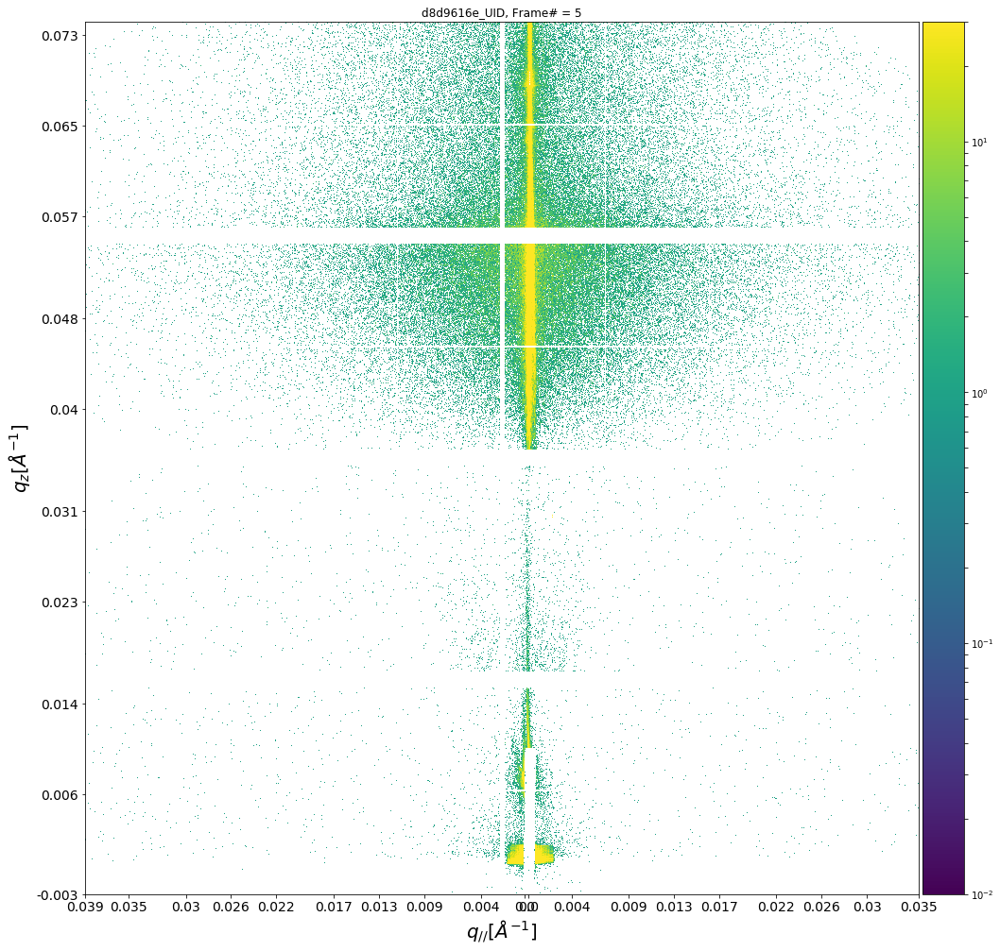

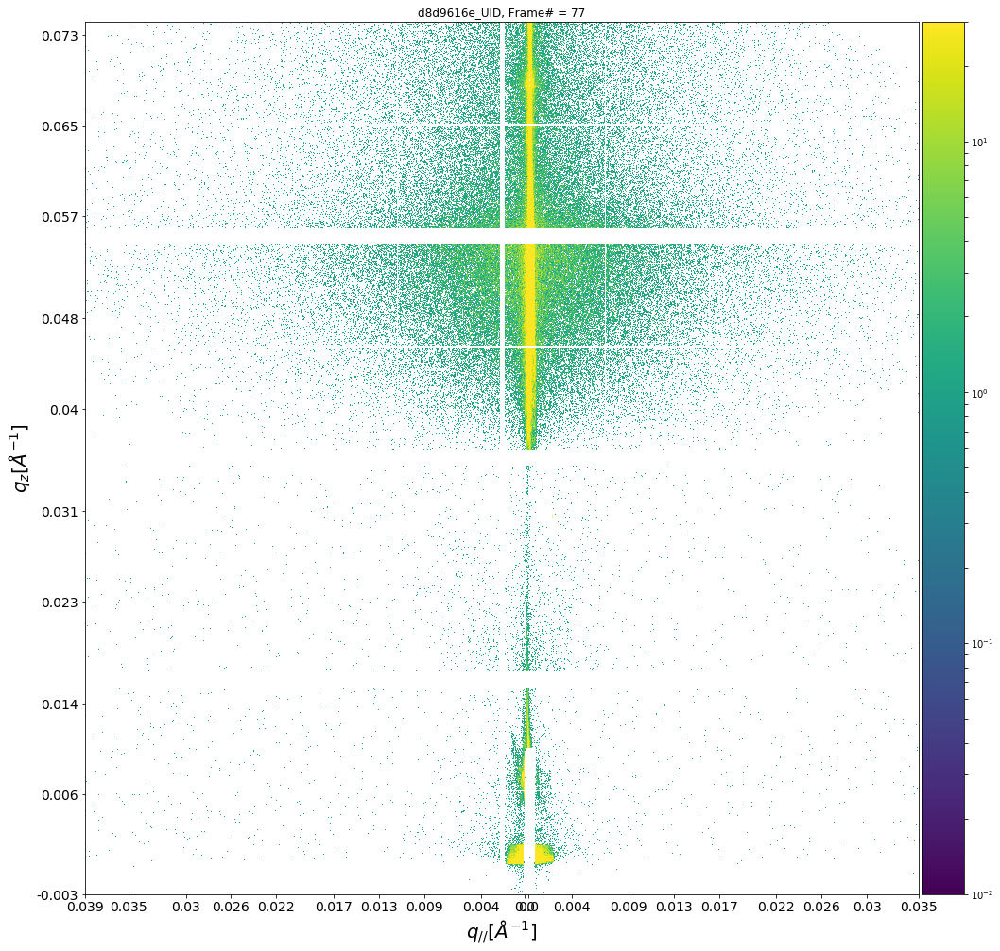

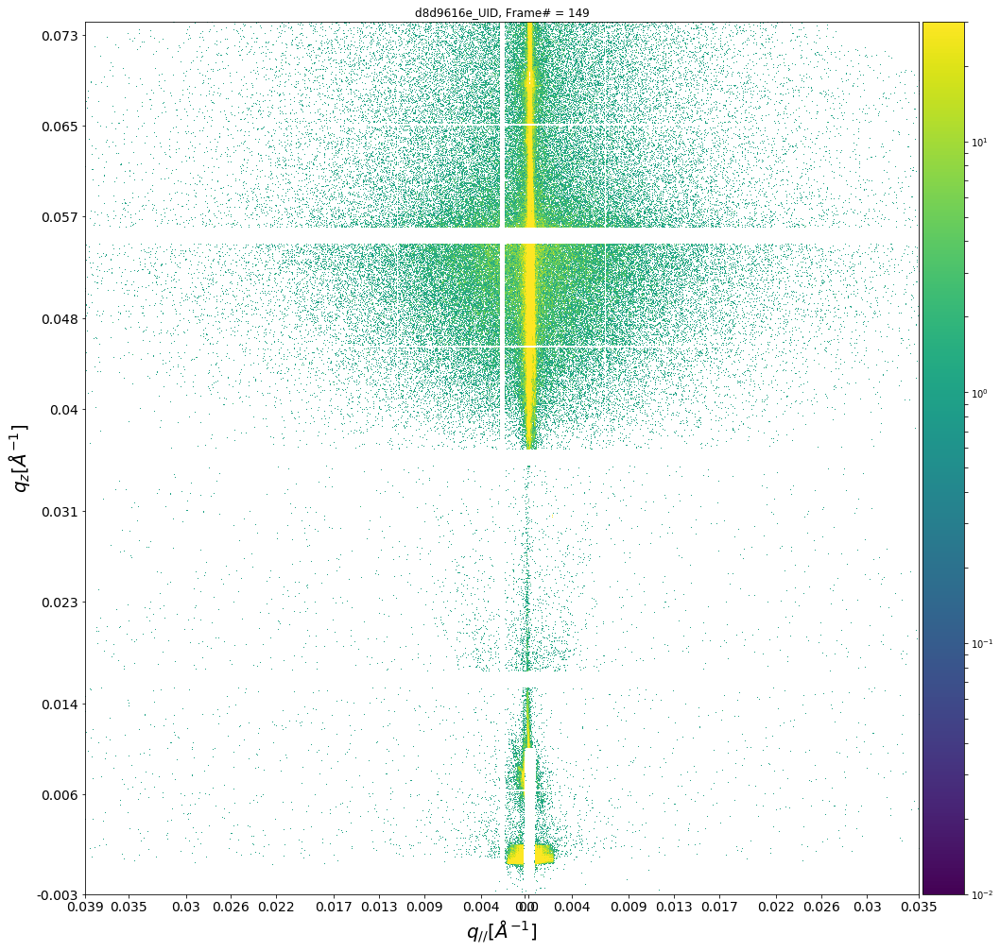

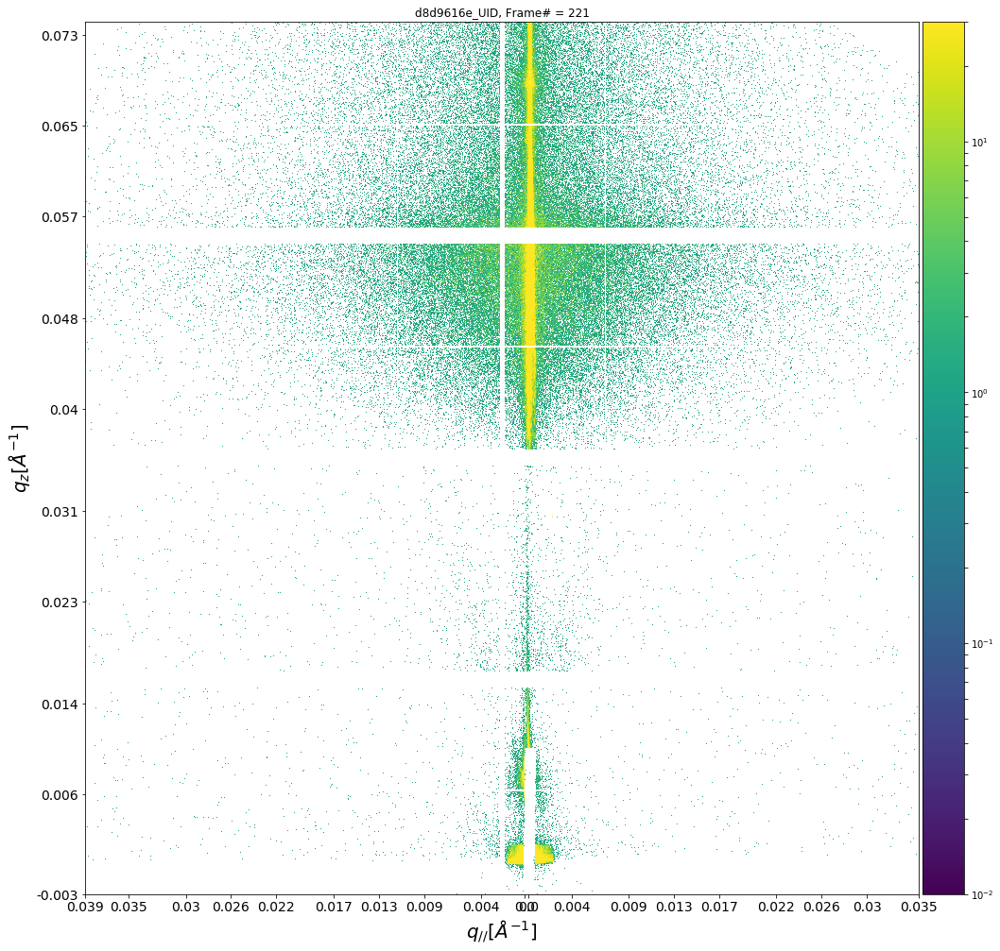

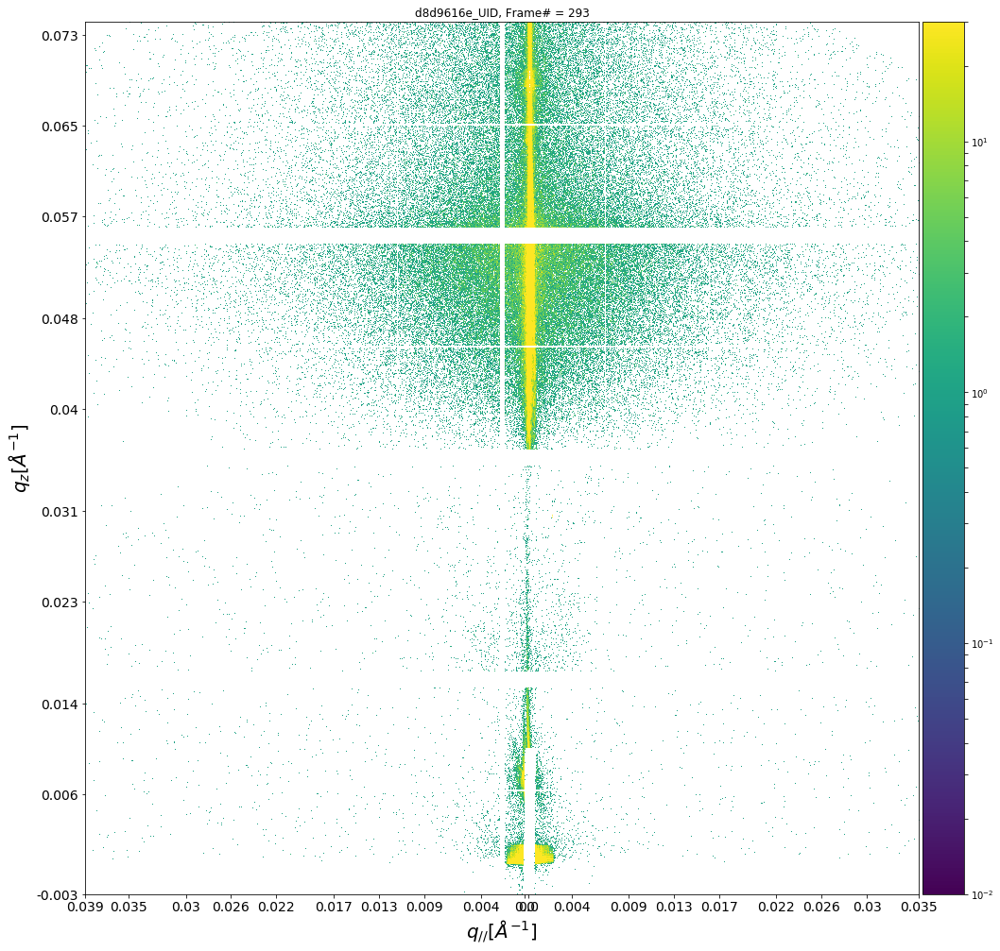

...

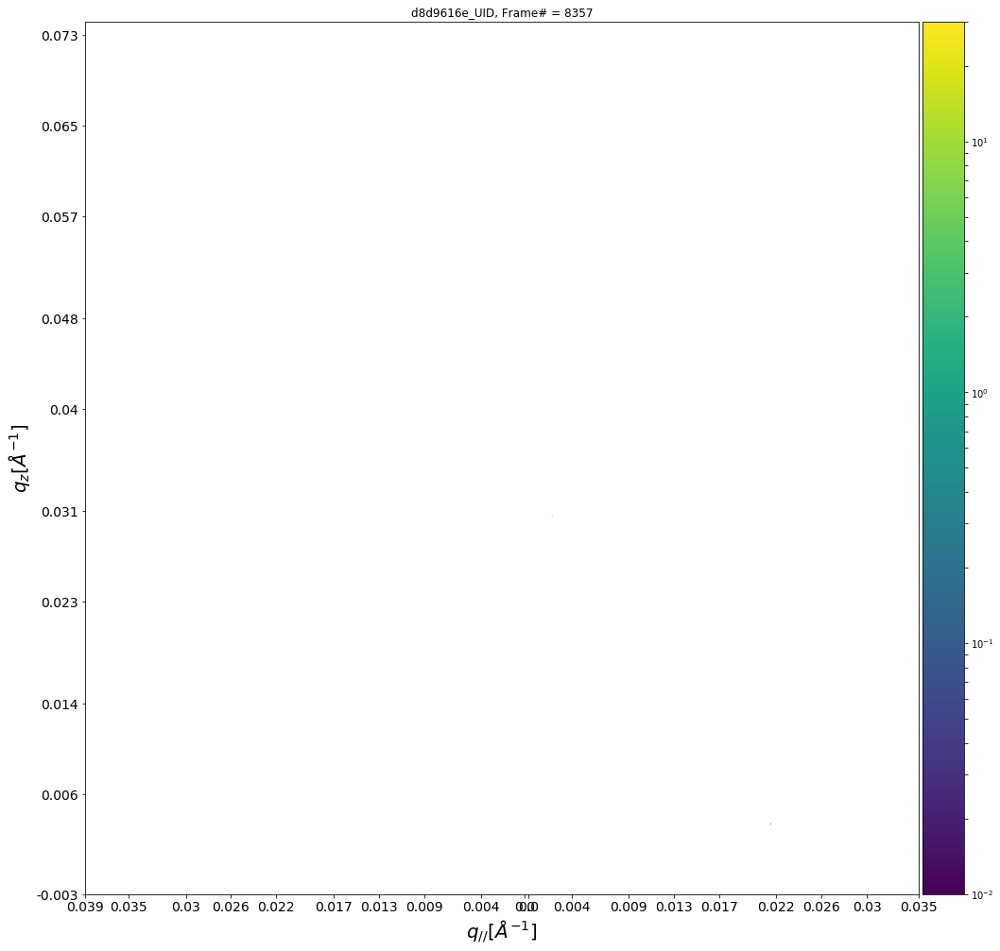

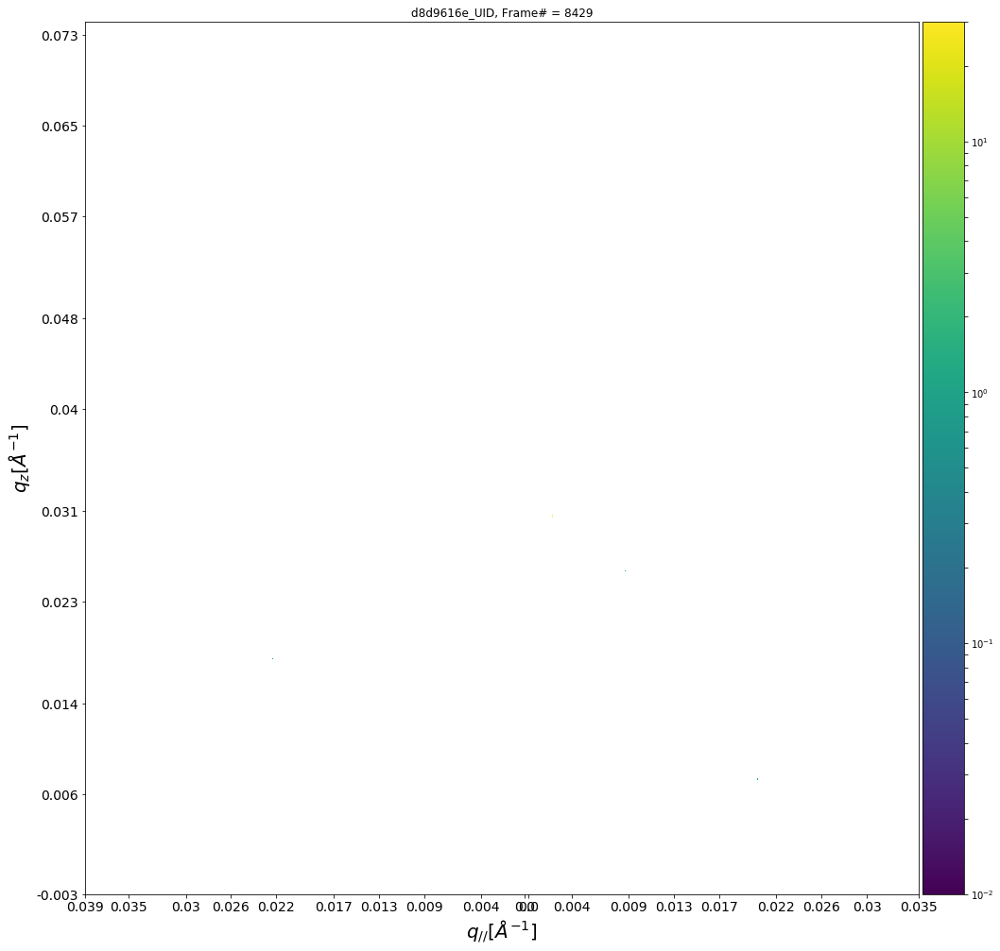

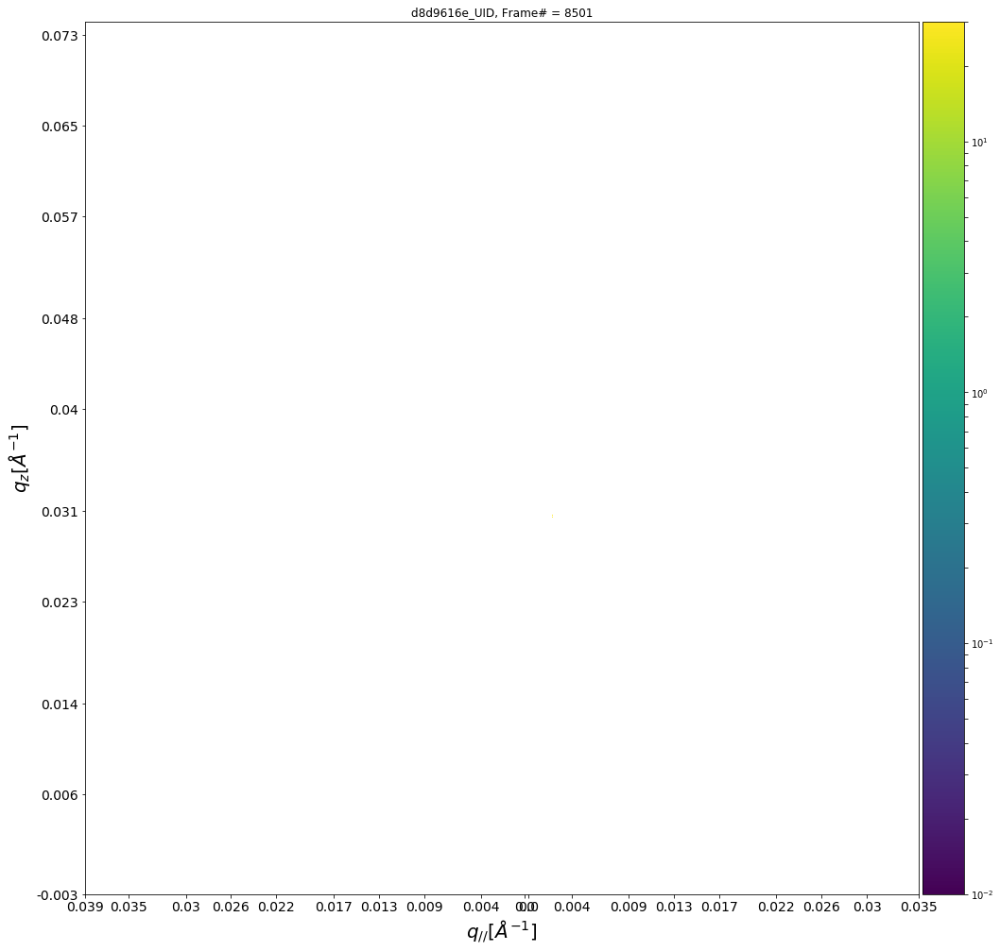

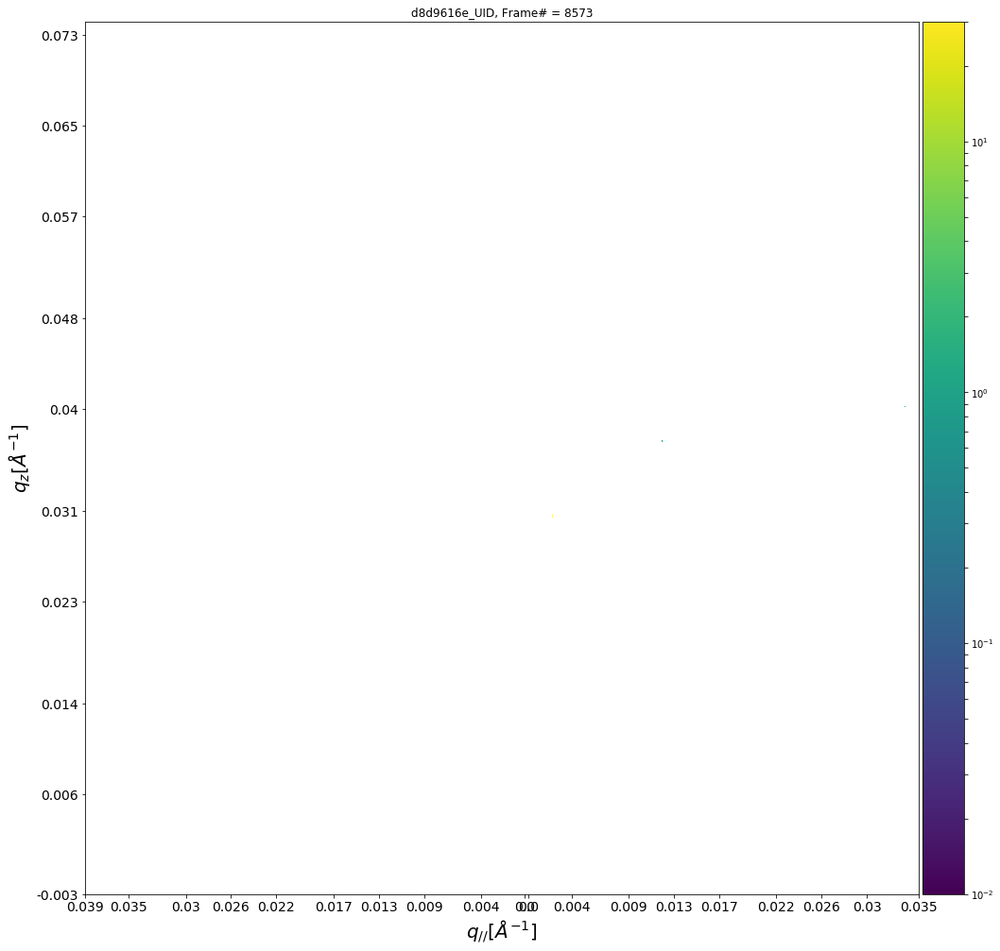

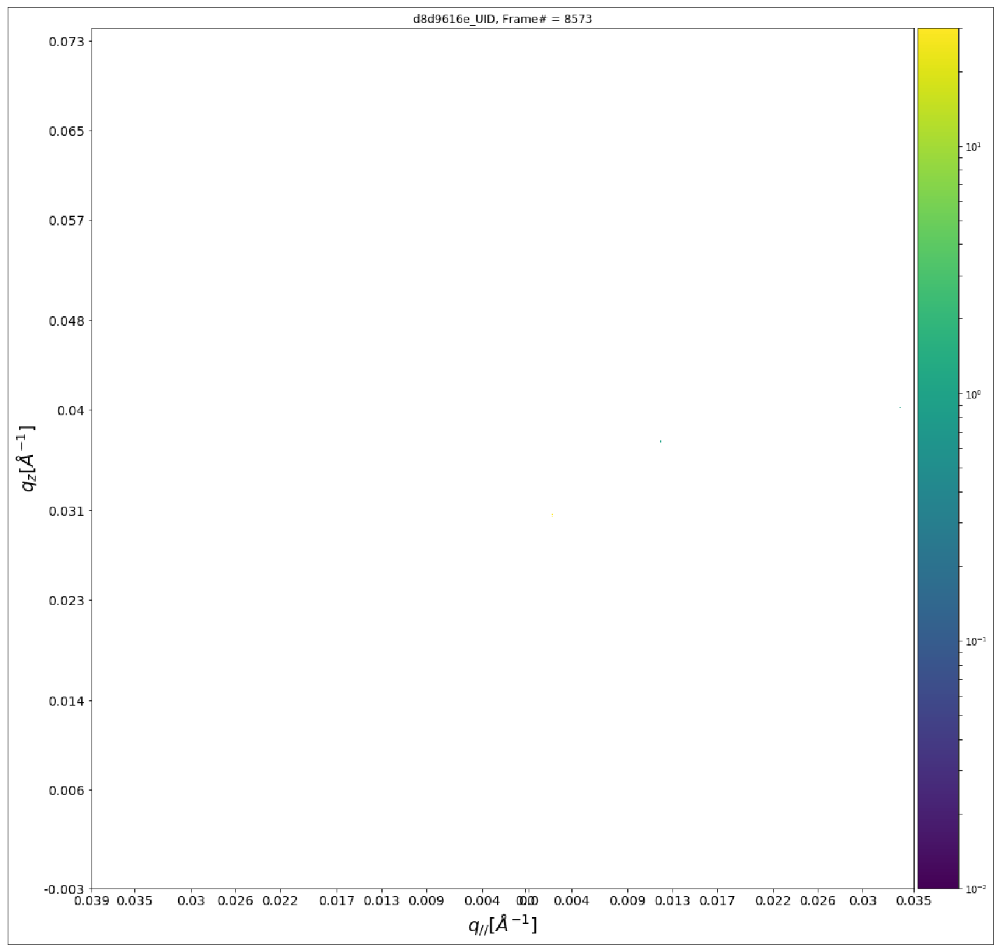

In [882]:
fps= 15#round(DD.DD['numberfiles']/8)
movielength = 8
zticks, zticks_label, rticks, rticks_label = ticks[:4]
p = 1
alpha=0.5
vmin=0.01
vmax=30.
for i in tqdm(np.arange(5,FD.end,round(FD.end/(fps*movielength)))):
    number = np.int_(round(i))
    avg_imgr, box_maskr = FD.rdframe(number), roi_masks
    num_qzr = len(np.unique( box_maskr)) -1
        #fig, ax = plt.subplots(figsize=(8,12))
    fig, ax = plt.subplots(figsize=(17,17))
    im,im_label = show_label_array_on_image(ax, avg_imgr, box_maskr, imshow_cmap='viridis',
                            cmap='Paired', alpha=alpha,
                             vmin=vmin, vmax=vmax,  origin="lower")
    ax.set_title("%s_UID, "%uid + 'Frame# = ' + np.str_(number))
    #stride = int(len(zticks)/3)
    stride = 1
    ax.set_yticks( zticks[::stride] )
    yticks =  zticks_label[::stride]
    ax.set_yticklabels(yticks, fontsize=14)
    #stride = int(len(rticks)/3)
    stride = 1
    ax.set_xticks( rticks[::stride] )
    xticks =  rticks_label[::stride]
    ax.set_xticklabels(xticks, fontsize=14)
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(im, cax=cax)
    
    ax.set_xlabel(r'$q_{//}[\AA^{-1}]$', fontsize=20)
    ax.set_ylabel(r'$q_z[\AA^{-1}]$',fontsize=20)
    directory_exists = os.path.isdir('/home/pmyint/' + '%s_'%(uid) +'/')
    if directory_exists == False:
        os.makedirs('/home/pmyint/' + '%s_'%(uid) +'/')
    fp = '/home/pmyint/' + '%s_'%(uid) +'/' + np.str_(p) + '.png'
    plt.savefig(fp,bbox_inches='tight')
    
    del avg_imgr, fp
    p+=1
fps_movie = fps
movie_maker(read_imgs('/home/pmyint/' + '%s_'%(uid)), num_frames=None, ROI=None,interval=20, fps=fps_movie, real_interval = 1.0, movie_name='%s_'%(uid) +'_all' + '.mp4', outDir=None,movie_writer='ffmpeg', logs=True, show_text_on_image=False,vmin=None, vmax=None,cmap='viridis',dpi=100)

